# Importing

In [1]:
#!pip install pillow
#!pip install tensorflow
#!pip install matplotlib
#!pip install tensorflow_io


[notice] A new release of pip available: 22.2.2 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
%env SM_FRAMEWORK=tf.keras
from PIL import Image
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os

import segmentation_models as sm
import matplotlib.pyplot as plt 
import tensorflow_io as tfio
import tensorflow as tf


env: SM_FRAMEWORK=tf.keras
Segmentation Models: using `tf.keras` framework.


# DRIVE

In [62]:
#A LITTLE BIT OF A DEFS
exts = ('jpg', 'JPG', 'png', 'PNG', 'tif', 'gif', 'ppm')
root = os.path.split(os.getcwd())[0]
#\Retina Segmentation
input_data = os.path.join(root, 'data/raw/DRIVE/training/images')
images = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir(input_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)


target_data = os.path.join(root, 'data/raw/DRIVE/training/1st_manual')
masks = sorted(
    [
        os.path.join(target_data, fname)
        for fname in os.listdir(target_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

print("Number of samples:", len(images), len(masks))
for input_path, target_path in zip(images[:10], masks[:10]):
    print(input_path[-31:], "|", target_path[-34:])
    

Number of samples: 20 20
training/images\21_training.tif | training/1st_manual\21_manual1.gif
training/images\22_training.tif | training/1st_manual\22_manual1.gif
training/images\23_training.tif | training/1st_manual\23_manual1.gif
training/images\24_training.tif | training/1st_manual\24_manual1.gif
training/images\25_training.tif | training/1st_manual\25_manual1.gif
training/images\26_training.tif | training/1st_manual\26_manual1.gif
training/images\27_training.tif | training/1st_manual\27_manual1.gif
training/images\28_training.tif | training/1st_manual\28_manual1.gif
training/images\29_training.tif | training/1st_manual\29_manual1.gif
training/images\30_training.tif | training/1st_manual\30_manual1.gif


# Reading files

In [7]:
IMAGE_SIZE = 512
BATCH_SIZE = 2 #was 12

def read_files(image_path, mask=False):
    image = tf.io.read_file(image_path)
    if mask:
        image = tf.io.decode_gif(image) # out: (1, h, w, 3)
        image = tf.squeeze(image) # out: (h, w, 3)
        image = tf.image.rgb_to_grayscale(image) # out: (h, w, 1)
        image = tf.divide(image, 128)
        image.set_shape([None, None, 1])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = tf.cast(image, tf.int32)
    else:
        image = tfio.experimental.image.decode_tiff(image) # out: (h, w, 4)
        image = image[:,:,:3] # out: (h, w, 3)
        image.set_shape([None, None, 3])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = image / 255.
    return image

def load_data(image_list, mask_list):
    image = read_files(image_list)
    mask  = read_files(mask_list, mask=True)
    return image, mask

def data_generator(image_list, mask_list):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=False)
    return dataset
print(masks[0])
print(images[0])
train_dataset = data_generator(images, masks)
train_dataset

C:\Users\HP\Desktop\IT Projects\Clean Medical Imagery\Retina Segmentation\data/raw/DRIVE/training/1st_manual\21_manual1.gif
C:\Users\HP\Desktop\IT Projects\Clean Medical Imagery\Retina Segmentation\data/raw/DRIVE/training/images\21_training.tif


<BatchDataset element_spec=(TensorSpec(shape=(None, 512, 512, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 512, 512, 1), dtype=tf.int32, name=None))>

# Visualize Image + Mask

In [11]:
def visualize(**images):
    """PLot images in one row."""
    n = len(images) 
    plt.figure(figsize=(20, 20))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image, cmap='gray')
    plt.show()

(2, 512, 512, 3) (2, 512, 512, 1)
0 1
[0 1]


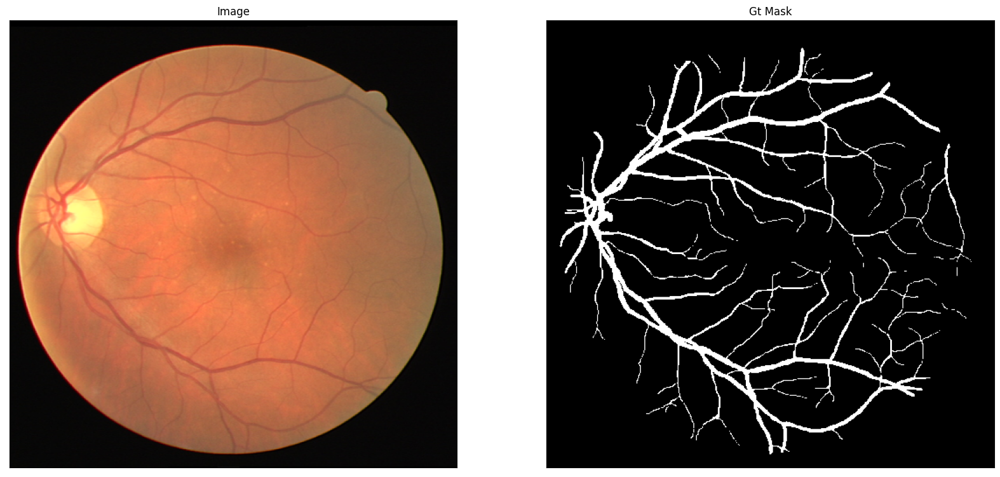

0 1
[0 1]


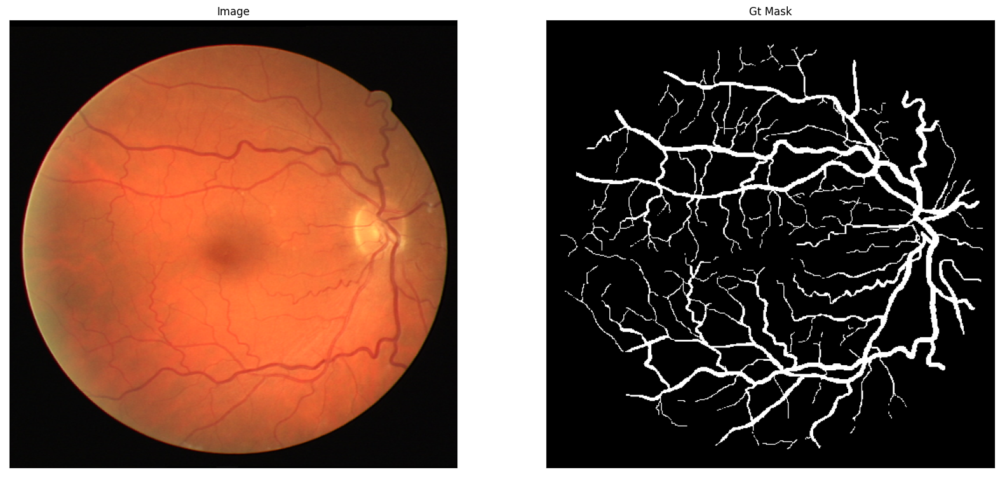

In [12]:
image, mask = next(iter(train_dataset.take(1))) 
print(image.shape, mask.shape)

for (img, msk) in zip(image[:10], mask[:10]):
    print(mask.numpy().min(), mask.numpy().max())
    print(np.unique(mask.numpy()))
    visualize(
        image=img.numpy(),
        gt_mask=msk.numpy(),
    )

# Base Model Architecture

In [13]:
from tensorflow import keras 

# Free up RAM in case the model definition cells were run multiple times
keras.backend.clear_session()
BACKBONE   = 'efficientnetb0'
n_classes  = 1 
activation = 'sigmoid' 
model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
model.summary(line_length=110)

Model: "model"
______________________________________________________________________________________________________________
 Layer (type)                       Output Shape            Param #      Connected to                         
 input_1 (InputLayer)               [(None, None, None, 3)  0            []                                   
                                    ]                                                                         
                                                                                                              
 stem_conv (Conv2D)                 (None, None, None, 32)  864          ['input_1[0][0]']                    
                                                                                                              
 stem_bn (BatchNormalization)       (None, None, None, 32)  128          ['stem_conv[0][0]']                  
                                                                                                 

                                                                                                              
 block2b_dwconv (DepthwiseConv2D)   (None, None, None, 144  1296         ['block2b_expand_activation[0][0]']  
                                    )                                                                         
                                                                                                              
 block2b_bn (BatchNormalization)    (None, None, None, 144  576          ['block2b_dwconv[0][0]']             
                                    )                                                                         
                                                                                                              
 block2b_activation (Activation)    (None, None, None, 144  0            ['block2b_bn[0][0]']                 
                                    )                                                                         
 

 ion)                               )                                                                         
                                                                                                              
 block3b_dwconv (DepthwiseConv2D)   (None, None, None, 240  6000         ['block3b_expand_activation[0][0]']  
                                    )                                                                         
                                                                                                              
 block3b_bn (BatchNormalization)    (None, None, None, 240  960          ['block3b_dwconv[0][0]']             
                                    )                                                                         
                                                                                                              
 block3b_activation (Activation)    (None, None, None, 240  0            ['block3b_bn[0][0]']                 
 

 block4b_expand_activation (Activat  (None, None, None, 480  0           ['block4b_expand_bn[0][0]']          
 ion)                               )                                                                         
                                                                                                              
 block4b_dwconv (DepthwiseConv2D)   (None, None, None, 480  4320         ['block4b_expand_activation[0][0]']  
                                    )                                                                         
                                                                                                              
 block4b_bn (BatchNormalization)    (None, None, None, 480  1920         ['block4b_dwconv[0][0]']             
                                    )                                                                         
                                                                                                              
 

 block5a_expand_conv (Conv2D)       (None, None, None, 480  38400        ['block4c_add[0][0]']                
                                    )                                                                         
                                                                                                              
 block5a_expand_bn (BatchNormalizat  (None, None, None, 480  1920        ['block5a_expand_conv[0][0]']        
 ion)                               )                                                                         
                                                                                                              
 block5a_expand_activation (Activat  (None, None, None, 480  0           ['block5a_expand_bn[0][0]']          
 ion)                               )                                                                         
                                                                                                              
 

                                                                                                              
 block5b_add (Add)                  (None, None, None, 112  0            ['block5b_drop[0][0]',               
                                    )                                     'block5a_project_bn[0][0]']         
                                                                                                              
 block5c_expand_conv (Conv2D)       (None, None, None, 672  75264        ['block5b_add[0][0]']                
                                    )                                                                         
                                                                                                              
 block5c_expand_bn (BatchNormalizat  (None, None, None, 672  2688        ['block5c_expand_conv[0][0]']        
 ion)                               )                                                                         
 

                                    )                                     'block6a_se_expand[0][0]']          
                                                                                                              
 block6a_project_conv (Conv2D)      (None, None, None, 192  129024       ['block6a_se_excite[0][0]']          
                                    )                                                                         
                                                                                                              
 block6a_project_bn (BatchNormaliza  (None, None, None, 192  768         ['block6a_project_conv[0][0]']       
 tion)                              )                                                                         
                                                                                                              
 block6b_expand_conv (Conv2D)       (None, None, None, 115  221184       ['block6a_project_bn[0][0]']         
 

                                                                                                              
 block6c_se_expand (Conv2D)         (None, 1, 1, 1152)      56448        ['block6c_se_reduce[0][0]']          
                                                                                                              
 block6c_se_excite (Multiply)       (None, None, None, 115  0            ['block6c_activation[0][0]',         
                                    2)                                    'block6c_se_expand[0][0]']          
                                                                                                              
 block6c_project_conv (Conv2D)      (None, None, None, 192  221184       ['block6c_se_excite[0][0]']          
                                    )                                                                         
                                                                                                              
 

                                                                                                              
 block7a_activation (Activation)    (None, None, None, 115  0            ['block7a_bn[0][0]']                 
                                    2)                                                                        
                                                                                                              
 block7a_se_squeeze (GlobalAverageP  (None, 1152)           0            ['block7a_activation[0][0]']         
 ooling2D)                                                                                                    
                                                                                                              
 block7a_se_reshape (Reshape)       (None, 1, 1, 1152)      0            ['block7a_se_squeeze[0][0]']         
                                                                                                              
 

 tion)                              )                                                                         
                                                                                                              
 decoder_stage1b_relu (Activation)  (None, None, None, 128  0            ['decoder_stage1b_bn[0][0]']         
                                    )                                                                         
                                                                                                              
 decoder_stage2_upsampling (UpSampl  (None, None, None, 128  0           ['decoder_stage1b_relu[0][0]']       
 ing2D)                             )                                                                         
                                                                                                              
 decoder_stage2_concat (Concatenate  (None, None, None, 272  0           ['decoder_stage2_upsampling[0][0]',  
 

# Callback : Monitoring Training Progress

In [48]:
class DisplayCallback(keras.callbacks.Callback):
    def __init__(self, dataset, epoch_interval=5):
        self.dataset = dataset
        self.epoch_interval = epoch_interval
    
    def display(self, display_list, extra_title=''):
        plt.figure(figsize=(15, 15))
        title = ['Input Image', 'True Mask', 'Predicted Mask']

        if len(display_list) > len(title):
            title.append(extra_title)

        for i in range(len(display_list)):
            plt.subplot(1, len(display_list), i+1)
            plt.title(title[i])
            plt.imshow(display_list[i], cmap='gray')
            plt.axis('off')
        plt.show()
        
    def create_mask(self, pred_mask):
        pred_mask = (pred_mask > 0.5).astype("int32")
        return pred_mask[0]
    
    def show_predictions(self, dataset, num=1):
        for image, mask in dataset.take(num):
            pred_mask = model.predict(image)
            self.display([image[0], mask[0], self.create_mask(pred_mask)])
        
    def on_epoch_end(self, epoch, logs=None):
        if epoch and epoch % self.epoch_interval == 0:
            self.show_predictions(self.dataset)
            print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

# Model Training

In [ ]:
# define optimizer
optim = keras.optimizers.Adam(0.0001)
bce   = keras.losses.BinaryCrossentropy()
metrics = ["accuracy"]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, bce, metrics)

model.fit(
    train_dataset, 
    callbacks=[DisplayCallback(train_dataset)],
    epochs=20
)

Epoch 1/20
10/10 [==============================] - 94s 7s/step - loss: 1.1260 - accuracy: 0.1490
Epoch 2/20
10/10 [==============================] - 62s 6s/step - loss: 0.9741 - accuracy: 0.2236
Epoch 3/20
10/10 [==============================] - 64s 6s/step - loss: 0.8596 - accuracy: 0.3638
Epoch 4/20
 8/10 [=======================>......] - ETA: 12s - loss: 0.7789 - accuracy: 0.4523

# CHASE DB1

In [63]:
hrf_dir = '../input/retinal-vessel-segmentation/CHASE_DB1'
#C:\Users\HP\Desktop\IT Projects\Clean Medical Imagery\Retina Segmentation\data\raw\CHASE_DB14
#input_data = os.path.join(root, 'Images')         \raw\CHASE_DB14\Images
root = os.path.split(os.getcwd())[0]

print(root)
input_data = os.path.join(root, 'data')
input_data = os.path.join(input_data, 'processed')
input_data = os.path.join(input_data, 'CHASE_DB1')
target_data = os.path.join(input_data, 'Masks')
input_data = os.path.join(input_data, 'Images')
print(input_data)
images = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir(input_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)


#target_data = os.path.join(root, 'data\raw\CHASE_DB1\Masks')   \Image_02L"
masks = sorted(
    [
        os.path.join(target_data, fname)
        for fname in os.listdir(target_data)
        if fname.endswith('_2ndHO.gif') and not fname.startswith(".") # _2ndHO.png, _1stHO.png
    ]
)
print(images)
print(masks)
len(images), len(masks)

def read_files_jpg(image_path, mask=False):
    o = image_path #I want this to remain a string as this is what I am receiving
    v = o.encode("utf-8").decode("ISO-8859-1")
    #io read file requires JPEG, PNG, GIF, BMP
    image = tf.io.read_file(image_path)
    if mask:
        image = tf.io.decode_image(image) # out: (1, h, w, 3)
        image = tf.squeeze(image) # out: (h, w, 3)
        image = tf.image.rgb_to_grayscale(image) # out: (h, w, 1)
        image = tf.divide(image, 128)
        image.set_shape([None, None, 1])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = tf.cast(image, tf.int32)
    else:
        image = tfio.experimental.image.decode_tiff(image) # out: (h, w, 4)
        image = image[:,:,:3] # out: (h, w, 3)
        image.set_shape([None, None, 3])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = image / 255.
    return image

print("Number of samples:", len(images), len(masks))
for input_path, target_path in zip(images, masks):
    print(input_path, "|", target_path)

C:\Users\HP\Desktop\IT Projects\Clean Medical Imagery\Retina Segmentation
C:\Users\HP\Desktop\IT Projects\Clean Medical Imagery\Retina Segmentation\data\processed\CHASE_DB1\Images
['C:\\Users\\HP\\Desktop\\IT Projects\\Clean Medical Imagery\\Retina Segmentation\\data\\processed\\CHASE_DB1\\Images\\image-01l.tif', 'C:\\Users\\HP\\Desktop\\IT Projects\\Clean Medical Imagery\\Retina Segmentation\\data\\processed\\CHASE_DB1\\Images\\image-01r.tif', 'C:\\Users\\HP\\Desktop\\IT Projects\\Clean Medical Imagery\\Retina Segmentation\\data\\processed\\CHASE_DB1\\Images\\image-02l.tif', 'C:\\Users\\HP\\Desktop\\IT Projects\\Clean Medical Imagery\\Retina Segmentation\\data\\processed\\CHASE_DB1\\Images\\image-03l.tif', 'C:\\Users\\HP\\Desktop\\IT Projects\\Clean Medical Imagery\\Retina Segmentation\\data\\processed\\CHASE_DB1\\Images\\image-03r.tif', 'C:\\Users\\HP\\Desktop\\IT Projects\\Clean Medical Imagery\\Retina Segmentation\\data\\processed\\CHASE_DB1\\Images\\image-04l.tif']
['C:\\Users\\HP

In [65]:
IMAGE_SIZE = 512
BATCH_SIZE = 2 #was 12

def read_files(image_path, mask=False):
    image = tf.io.read_file(image_path)
    if mask:
        image = tf.io.decode_gif(image) # out: (1, h, w, 3)
        image = tf.squeeze(image) # out: (h, w, 3)
        image = tf.image.rgb_to_grayscale(image) # out: (h, w, 1)
        image = tf.divide(image, 128)
        image.set_shape([None, None, 1])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = tf.cast(image, tf.int32)
    else:
        image = tfio.experimental.image.decode_tiff(image) # out: (h, w, 4)
        image = image[:,:,:3] # out: (h, w, 3)
        image.set_shape([None, None, 3])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = image / 255.
    return image

def load_data(image_list, mask_list):
    image = read_files(image_list)
    mask  = read_files(mask_list, mask=True)
    return image, mask

def data_generator(image_list, mask_list):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=False)
    return dataset
print(masks[0])
print(images[0])
train_dataset = data_generator(images[0:3], masks)
train_dataset

C:\Users\HP\Desktop\IT Projects\Clean Medical Imagery\Retina Segmentation\data\processed\CHASE_DB1\Masks\Image_01L_2ndHO.gif
C:\Users\HP\Desktop\IT Projects\Clean Medical Imagery\Retina Segmentation\data\processed\CHASE_DB1\Images\image-01l.tif


<BatchDataset element_spec=(TensorSpec(shape=(None, 512, 512, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 512, 512, 1), dtype=tf.int32, name=None))>

Epoch 1/20
2/2 [==============================] - 35s 5s/step - loss: 0.7872 - accuracy: 0.5144
Epoch 2/20
2/2 [==============================] - 12s 4s/step - loss: 0.7513 - accuracy: 0.5333
Epoch 3/20
2/2 [==============================] - 12s 4s/step - loss: 0.7252 - accuracy: 0.5502
Epoch 4/20
2/2 [==============================] - 12s 4s/step - loss: 0.7018 - accuracy: 0.5687
Epoch 5/20
2/2 [==============================] - 12s 4s/step - loss: 0.6803 - accuracy: 0.5859
Epoch 6/20
1/1 [==============================] - 4s 4s/steploss: 0.6618 - accuracy: 0.60


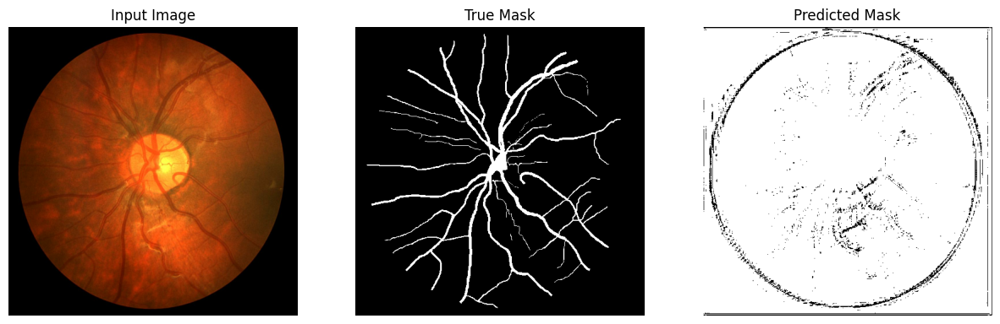


Sample Prediction after epoch 6

2/2 [==============================] - 16s 8s/step - loss: 0.6618 - accuracy: 0.6021
Epoch 7/20
2/2 [==============================] - 12s 4s/step - loss: 0.6462 - accuracy: 0.6162
Epoch 8/20
2/2 [==============================] - 12s 4s/step - loss: 0.6312 - accuracy: 0.6310
Epoch 9/20
2/2 [==============================] - 11s 4s/step - loss: 0.6186 - accuracy: 0.6464
Epoch 10/20
2/2 [==============================] - 12s 4s/step - loss: 0.6067 - accuracy: 0.6616
Epoch 11/20
1/1 [==============================] - 2s 2s/steploss: 0.5956 - accuracy: 0.67


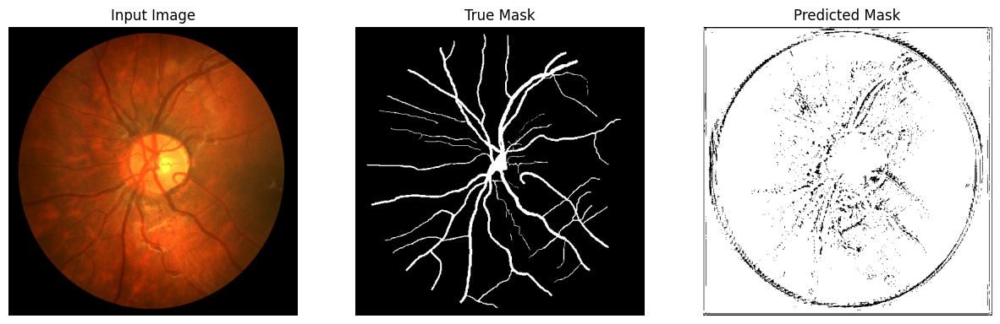


Sample Prediction after epoch 11

2/2 [==============================] - 14s 7s/step - loss: 0.5956 - accuracy: 0.6776
Epoch 12/20
2/2 [==============================] - 12s 4s/step - loss: 0.5854 - accuracy: 0.6919
Epoch 13/20
2/2 [==============================] - 11s 4s/step - loss: 0.5747 - accuracy: 0.7101
Epoch 14/20
2/2 [==============================] - 11s 4s/step - loss: 0.5643 - accuracy: 0.7270
Epoch 15/20
2/2 [==============================] - 12s 4s/step - loss: 0.5546 - accuracy: 0.7431
Epoch 16/20
1/1 [==============================] - 2s 2s/steploss: 0.5457 - accuracy: 0.75


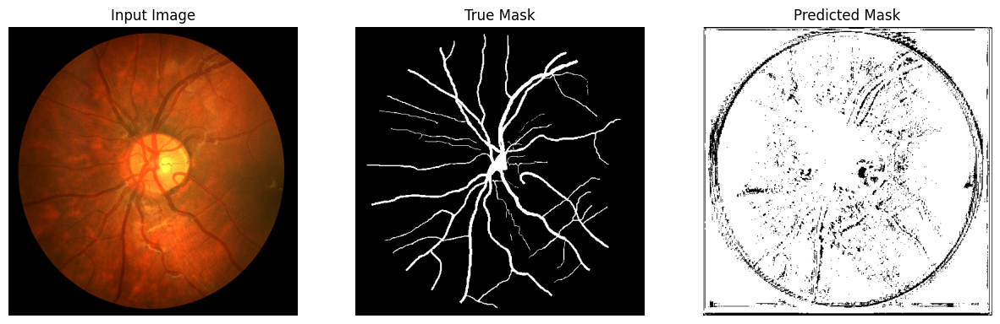


Sample Prediction after epoch 16

2/2 [==============================] - 14s 6s/step - loss: 0.5457 - accuracy: 0.7569
Epoch 17/20
2/2 [==============================] - 11s 4s/step - loss: 0.5367 - accuracy: 0.7699
Epoch 18/20
2/2 [==============================] - 12s 4s/step - loss: 0.5274 - accuracy: 0.7846
Epoch 19/20
2/2 [==============================] - 11s 4s/step - loss: 0.5192 - accuracy: 0.7983
Epoch 20/20
2/2 [==============================] - 12s 4s/step - loss: 0.5109 - accuracy: 0.8102


In [66]:
from tensorflow import keras 

# Free up RAM in case the model definition cells were run multiple times
keras.backend.clear_session()
BACKBONE   = 'efficientnetb0'
n_classes  = 1 
activation = 'sigmoid' 
model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
#model.summary(line_length=110)

# define optimizer
optim = keras.optimizers.Adam(0.0001)
bce   = keras.losses.BinaryCrossentropy()
metrics = ["accuracy"]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, bce, metrics)

model.fit(
    train_dataset, 
    callbacks=[DisplayCallback(train_dataset)],
    epochs=20
)

In [51]:
hrf_dir = r'C:\Users\HP\Desktop\IT Projects\Clean Medical Imagery\Retina Segmentation\data\raw\HRF'
input_data = os.path.join(hrf_dir, 'images')
images = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir(input_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)


target_data = os.path.join(hrf_dir, 'mask')
masks1 = sorted(
    [
        os.path.join(target_data, fname)
        for fname in os.listdir(target_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

target_data = os.path.join(hrf_dir, 'manual1')
masks2 = sorted(
    [
        os.path.join(target_data, fname)
        for fname in os.listdir(target_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

len(images), len(masks1), len(masks2)

(45, 45, 45)

In [52]:
def quick_plot(img, msk1, msk2):
    plt.figure(figsize=(25, 25))   
    plt.subplot(1, 3, 1)
    plt.axis('off')
    plt.imshow(img)
    plt.title('image')

    plt.subplot(1, 3, 2)
    plt.axis('off')
    plt.imshow(msk1)
    plt.title('mask type 1')

    plt.subplot(1, 3, 3)
    plt.axis('off')
    plt.imshow(msk2)
    plt.title('mask type 2')
    plt.show() 

01_dr.JPG  |  01_dr_mask.tif  |  01_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


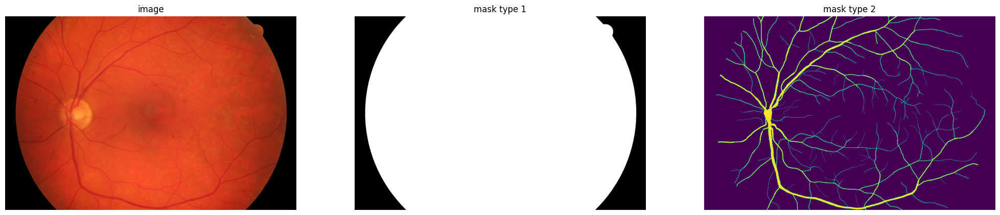

\01_g.jpg  |  \01_g_mask.tif  |  \01_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


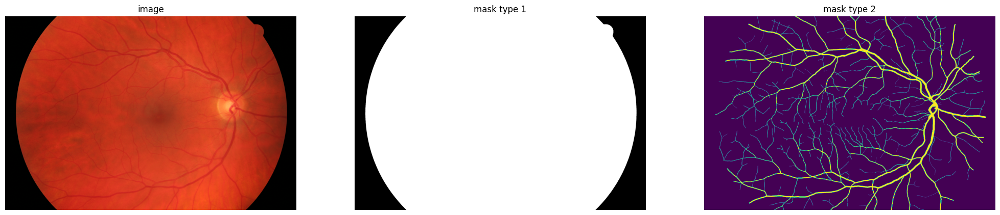

\01_h.jpg  |  \01_h_mask.tif  |  \01_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


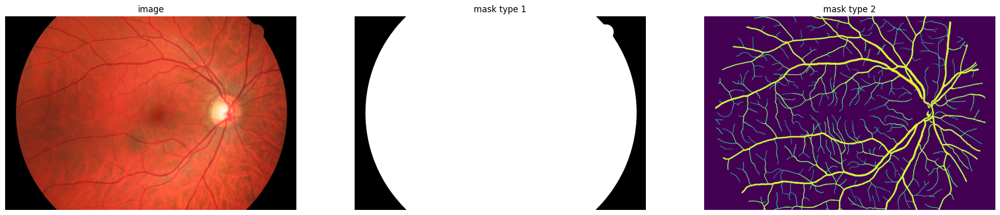

02_dr.JPG  |  02_dr_mask.tif  |  02_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


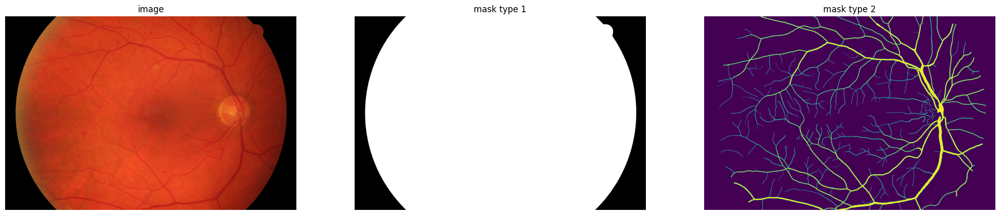

\02_g.jpg  |  \02_g_mask.tif  |  \02_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


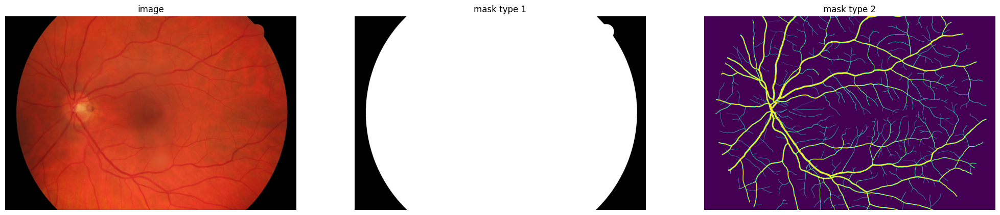

\02_h.jpg  |  \02_h_mask.tif  |  \02_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


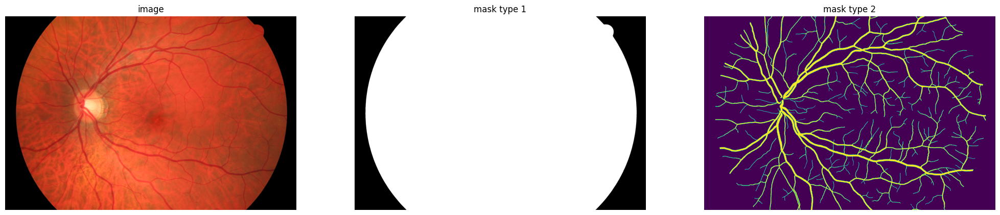

03_dr.JPG  |  03_dr_mask.tif  |  03_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


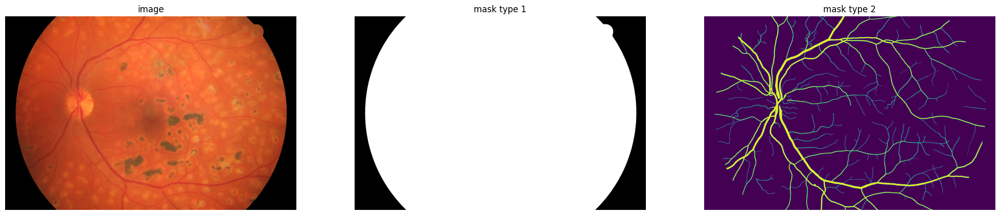

\03_g.jpg  |  \03_g_mask.tif  |  \03_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


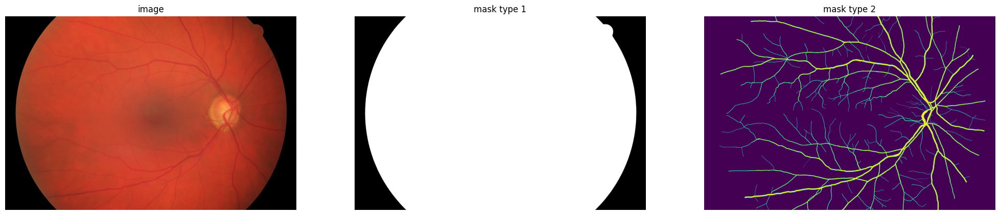

\03_h.jpg  |  \03_h_mask.tif  |  \03_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


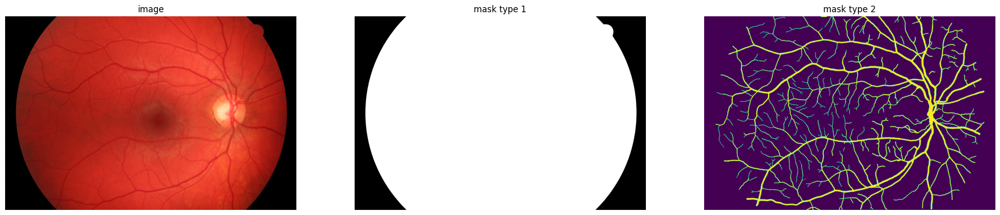

04_dr.JPG  |  04_dr_mask.tif  |  04_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


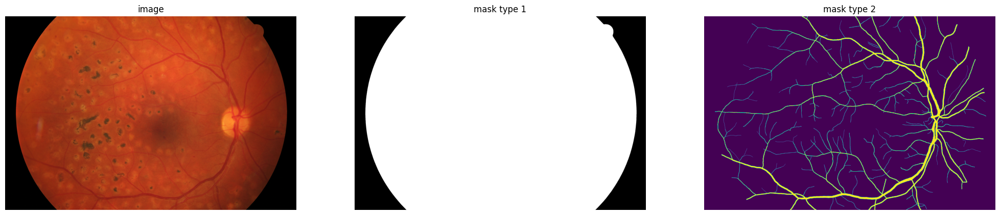

\04_g.jpg  |  \04_g_mask.tif  |  \04_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


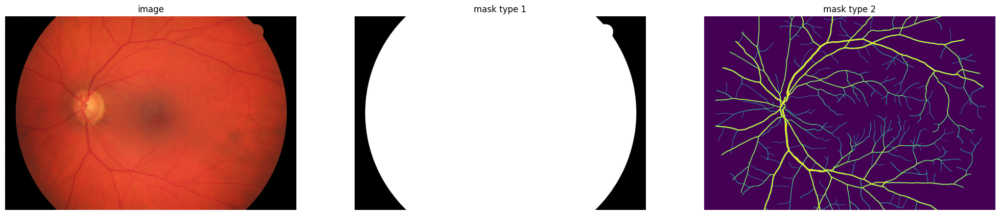

\04_h.jpg  |  \04_h_mask.tif  |  \04_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


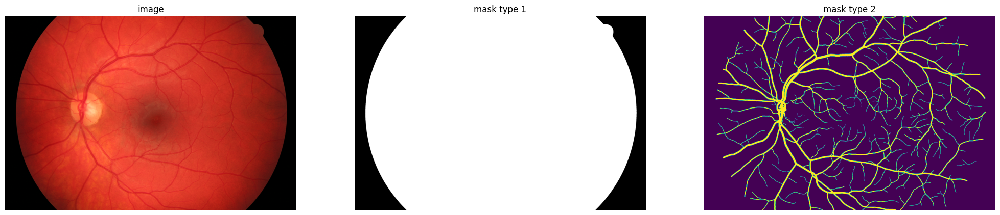

05_dr.JPG  |  05_dr_mask.tif  |  05_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


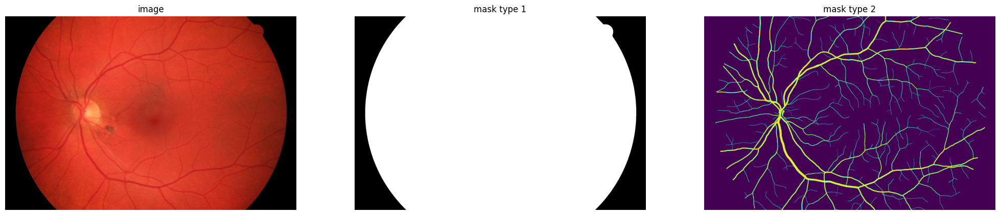

\05_g.jpg  |  \05_g_mask.tif  |  \05_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


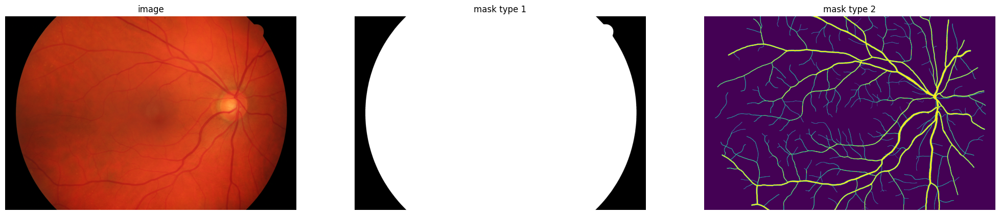

\05_h.jpg  |  \05_h_mask.tif  |  \05_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


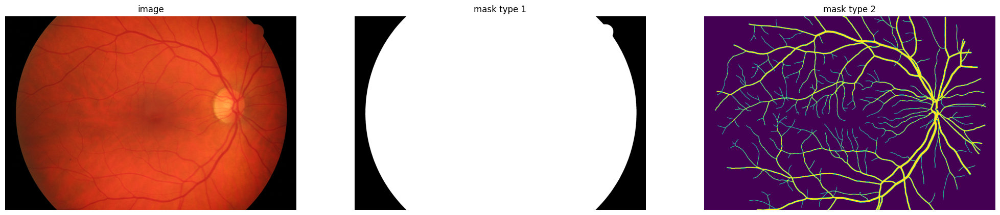

06_dr.JPG  |  06_dr_mask.tif  |  06_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


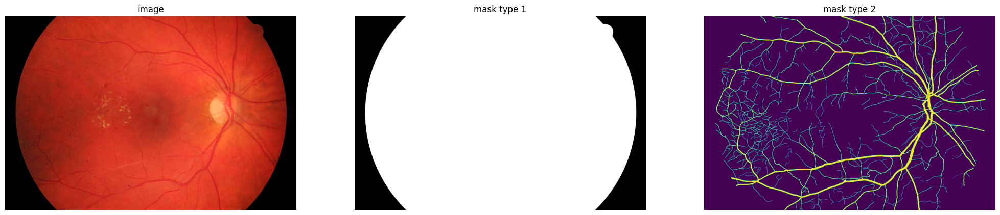

\06_g.jpg  |  \06_g_mask.tif  |  \06_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


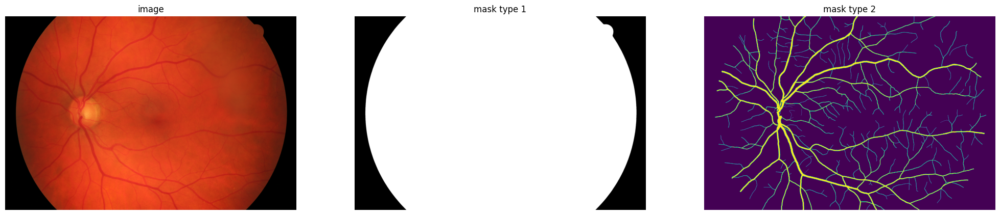

\06_h.jpg  |  \06_h_mask.tif  |  \06_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


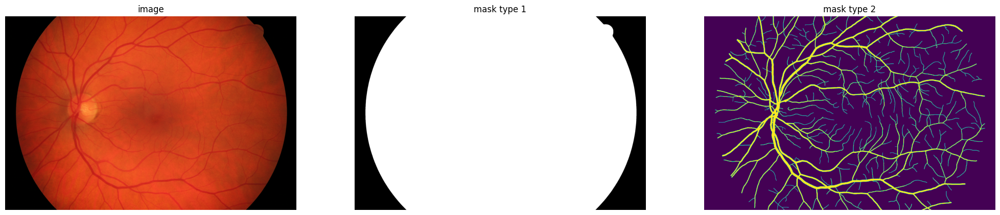

07_dr.JPG  |  07_dr_mask.tif  |  07_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


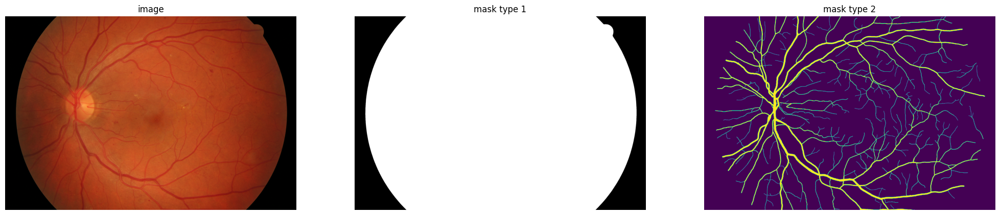

\07_g.jpg  |  \07_g_mask.tif  |  \07_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


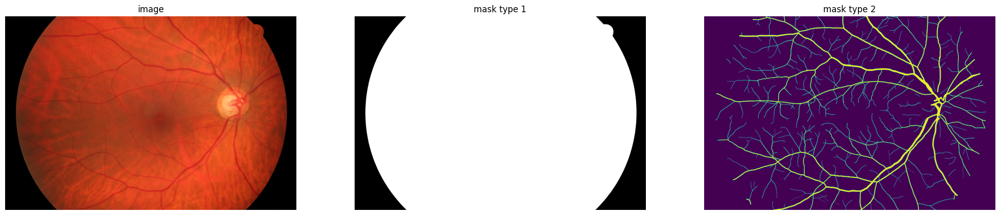

\07_h.jpg  |  \07_h_mask.tif  |  \07_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


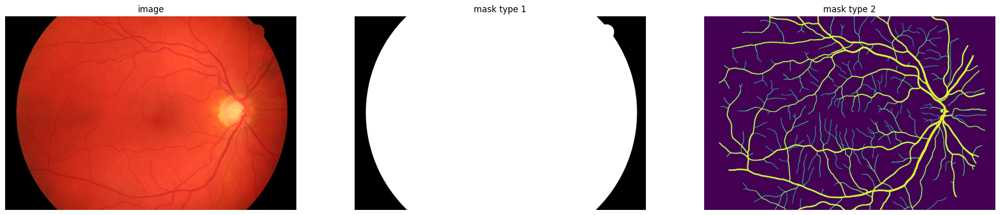

08_dr.JPG  |  08_dr_mask.tif  |  08_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


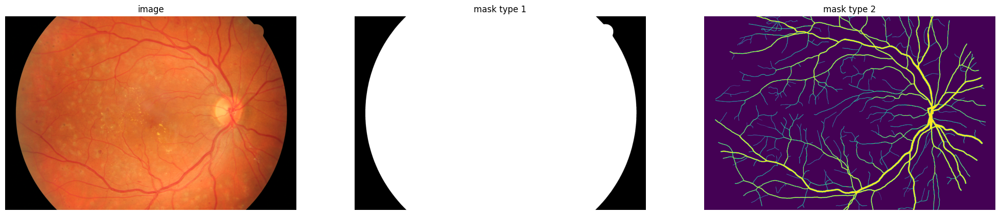

\08_g.jpg  |  \08_g_mask.tif  |  \08_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


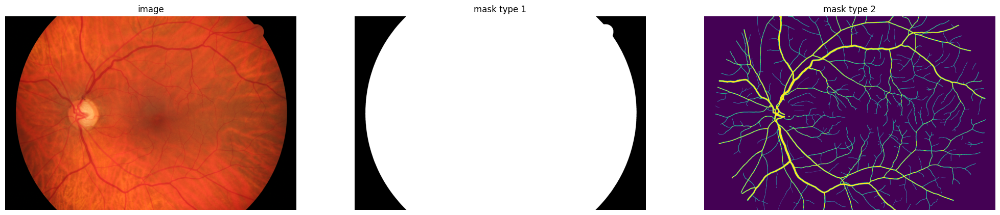

\08_h.jpg  |  \08_h_mask.tif  |  \08_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


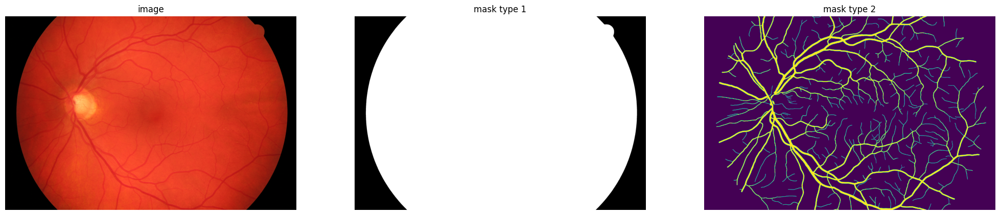

09_dr.JPG  |  09_dr_mask.tif  |  09_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


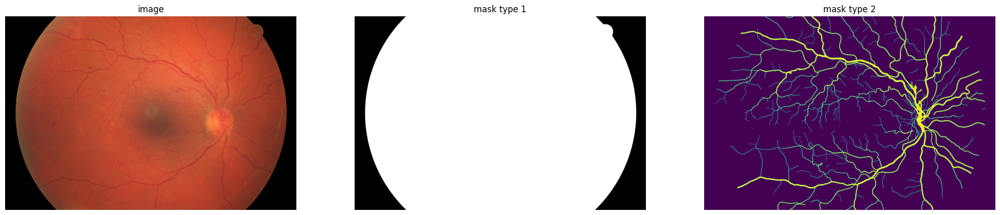

\09_g.jpg  |  \09_g_mask.tif  |  \09_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


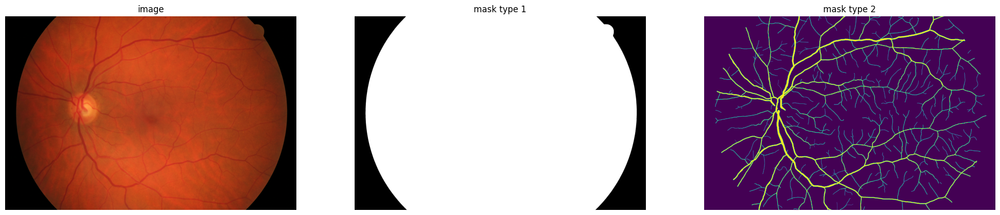

\09_h.jpg  |  \09_h_mask.tif  |  \09_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


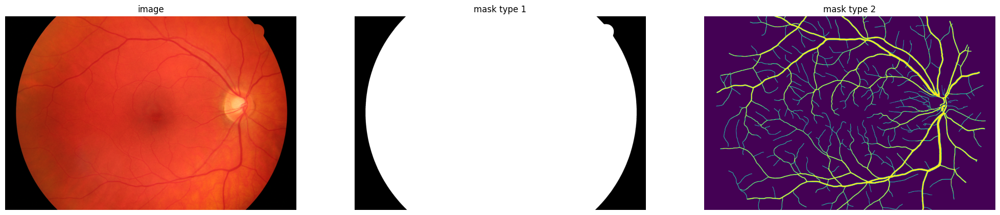

10_dr.JPG  |  10_dr_mask.tif  |  10_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


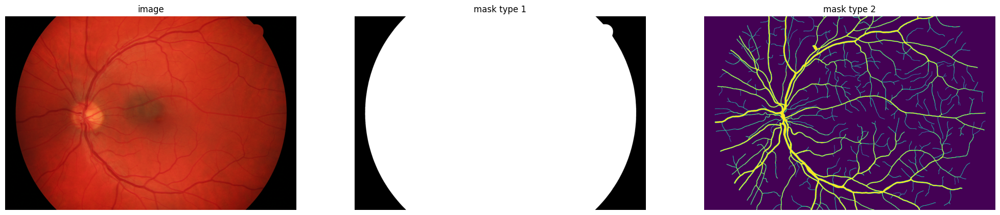

\10_g.jpg  |  \10_g_mask.tif  |  \10_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


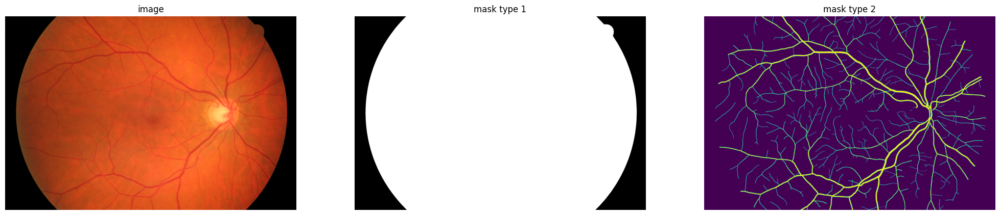

\10_h.jpg  |  \10_h_mask.tif  |  \10_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


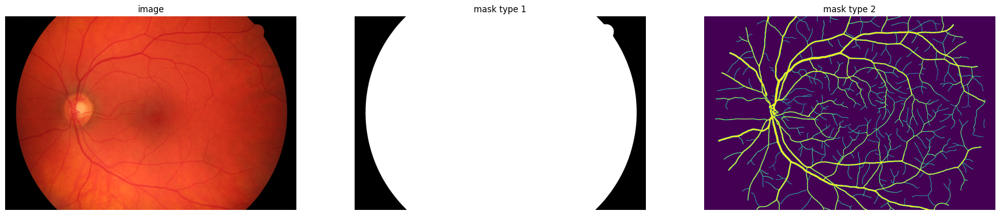

11_dr.JPG  |  11_dr_mask.tif  |  11_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


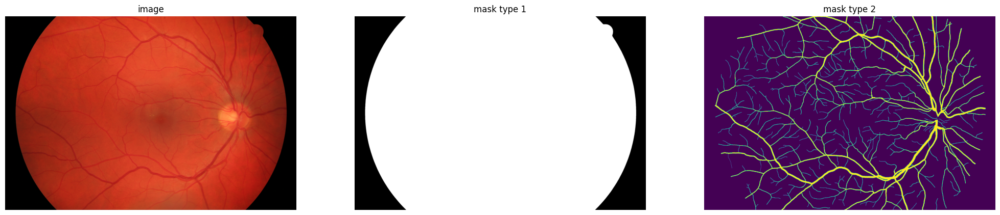

\11_g.jpg  |  \11_g_mask.tif  |  \11_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


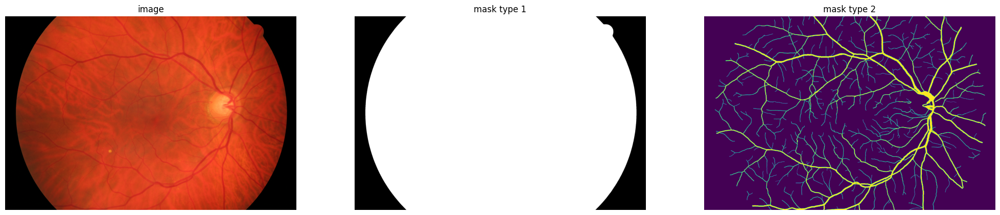

\11_h.jpg  |  \11_h_mask.tif  |  \11_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


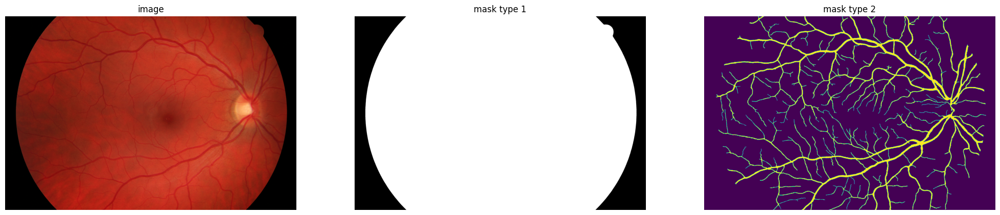

12_dr.JPG  |  12_dr_mask.tif  |  12_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


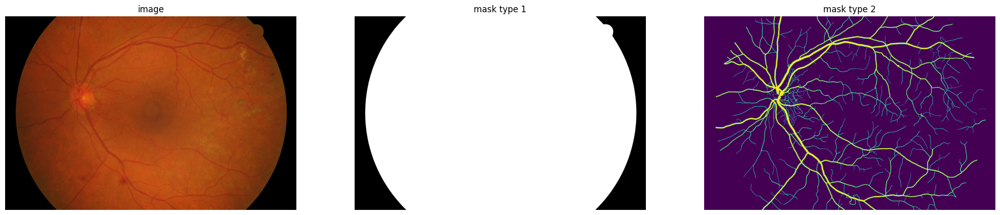

\12_g.jpg  |  \12_g_mask.tif  |  \12_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


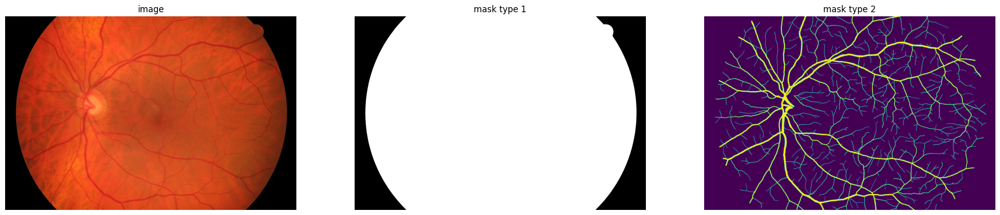

\12_h.jpg  |  \12_h_mask.tif  |  \12_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


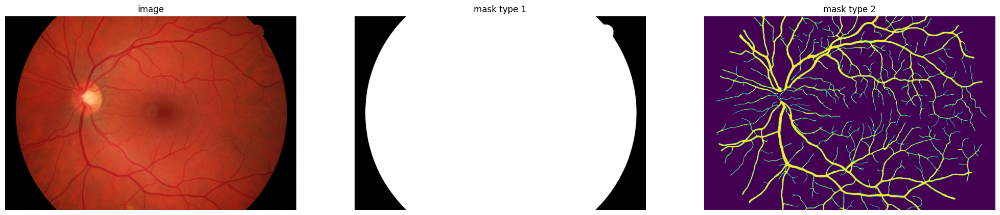

13_dr.JPG  |  13_dr_mask.tif  |  13_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


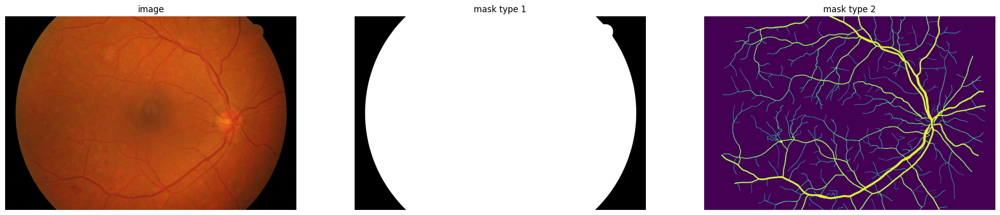

\13_g.jpg  |  \13_g_mask.tif  |  \13_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


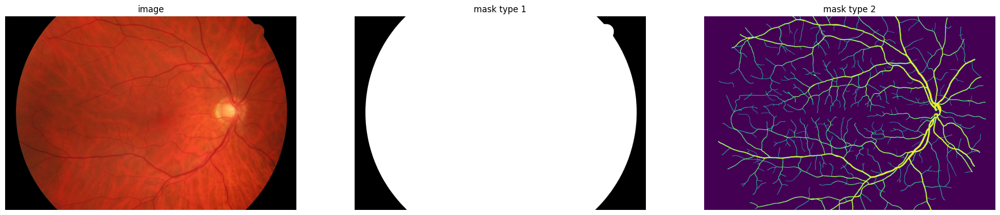

\13_h.jpg  |  \13_h_mask.tif  |  \13_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


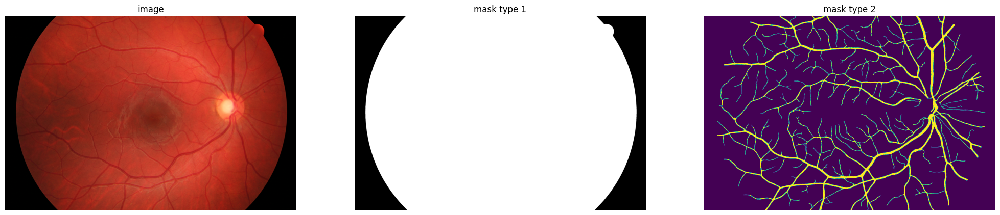

14_dr.JPG  |  14_dr_mask.tif  |  14_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


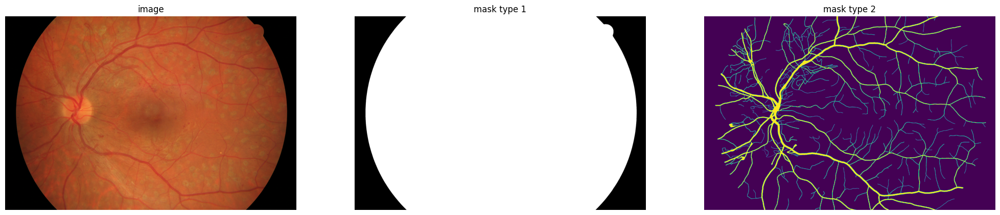

\14_g.jpg  |  \14_g_mask.tif  |  \14_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


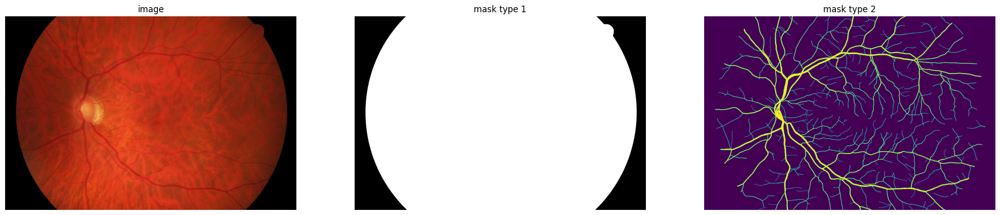

\14_h.jpg  |  \14_h_mask.tif  |  \14_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


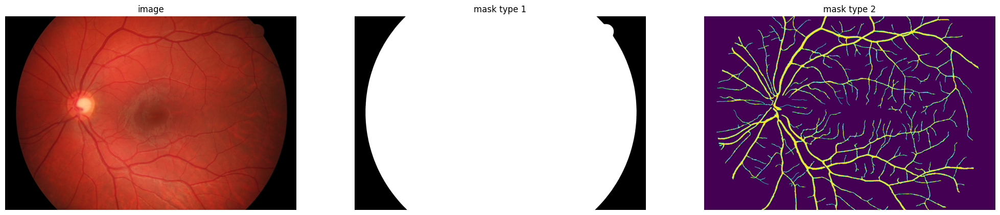

15_dr.JPG  |  15_dr_mask.tif  |  15_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


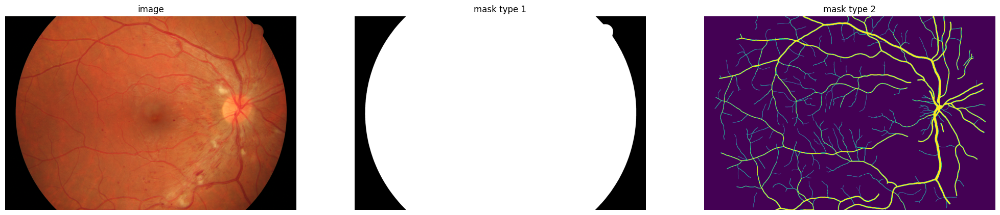

\15_g.jpg  |  \15_g_mask.tif  |  \15_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


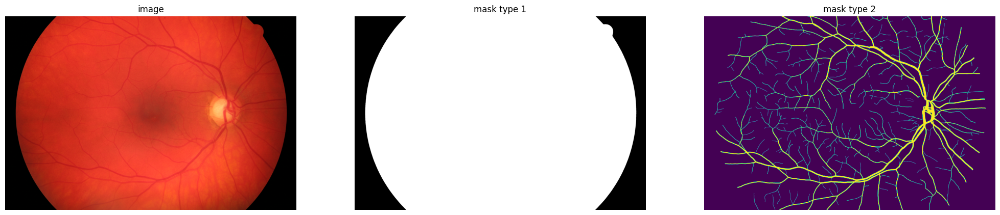

\15_h.jpg  |  \15_h_mask.tif  |  \15_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


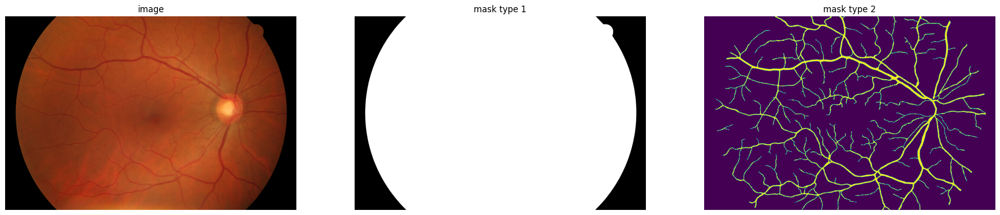

In [53]:
def quick_plot(img, msk1, msk2):
    plt.figure(figsize=(25, 25))   
    plt.subplot(1, 3, 1)
    plt.axis('off')
    plt.imshow(img)
    plt.title('image')

    plt.subplot(1, 3, 2)
    plt.axis('off')
    plt.imshow(msk1)
    plt.title('mask type 1')

    plt.subplot(1, 3, 3)
    plt.axis('off')
    plt.imshow(msk2)
    plt.title('mask type 2')
    plt.show() 


for img, msk1, msk2 in zip(images, masks1, masks2):
    print(img[-9:],' | ', msk1[-14:], ' | ', msk2[-9:])
    
    # read files 
    read_img  = Image.open(img)
    read_msk1 = Image.open(msk1)
    read_msk2 = Image.open(msk2)
    
    # plot them 
    print(read_img.size, read_msk1.size, read_msk2.size)
    quick_plot(read_img, read_msk1, read_msk2)

In [54]:
from tensorflow import keras 

train_dataset = data_generator(images, masks2)

# Free up RAM in case the model definition cells were run multiple times
keras.backend.clear_session()
BACKBONE   = 'efficientnetb0'
n_classes  = 1 
activation = 'sigmoid' 
model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
model.summary(line_length=110)

# define optimizer
optim = keras.optimizers.Adam(0.0001)
bce   = keras.losses.BinaryCrossentropy()
metrics = ["accuracy"]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, bce, metrics)

model.fit(
    train_dataset, 
    callbacks=[DisplayCallback(train_dataset)],
    epochs=20
)

Model: "model"
______________________________________________________________________________________________________________
 Layer (type)                       Output Shape            Param #      Connected to                         
 input_1 (InputLayer)               [(None, None, None, 3)  0            []                                   
                                    ]                                                                         
                                                                                                              
 stem_conv (Conv2D)                 (None, None, None, 32)  864          ['input_1[0][0]']                    
                                                                                                              
 stem_bn (BatchNormalization)       (None, None, None, 32)  128          ['stem_conv[0][0]']                  
                                                                                                 

                                                                                                              
 block2b_dwconv (DepthwiseConv2D)   (None, None, None, 144  1296         ['block2b_expand_activation[0][0]']  
                                    )                                                                         
                                                                                                              
 block2b_bn (BatchNormalization)    (None, None, None, 144  576          ['block2b_dwconv[0][0]']             
                                    )                                                                         
                                                                                                              
 block2b_activation (Activation)    (None, None, None, 144  0            ['block2b_bn[0][0]']                 
                                    )                                                                         
 

 ion)                               )                                                                         
                                                                                                              
 block3b_dwconv (DepthwiseConv2D)   (None, None, None, 240  6000         ['block3b_expand_activation[0][0]']  
                                    )                                                                         
                                                                                                              
 block3b_bn (BatchNormalization)    (None, None, None, 240  960          ['block3b_dwconv[0][0]']             
                                    )                                                                         
                                                                                                              
 block3b_activation (Activation)    (None, None, None, 240  0            ['block3b_bn[0][0]']                 
 

 block4b_expand_activation (Activat  (None, None, None, 480  0           ['block4b_expand_bn[0][0]']          
 ion)                               )                                                                         
                                                                                                              
 block4b_dwconv (DepthwiseConv2D)   (None, None, None, 480  4320         ['block4b_expand_activation[0][0]']  
                                    )                                                                         
                                                                                                              
 block4b_bn (BatchNormalization)    (None, None, None, 480  1920         ['block4b_dwconv[0][0]']             
                                    )                                                                         
                                                                                                              
 

 block5a_expand_conv (Conv2D)       (None, None, None, 480  38400        ['block4c_add[0][0]']                
                                    )                                                                         
                                                                                                              
 block5a_expand_bn (BatchNormalizat  (None, None, None, 480  1920        ['block5a_expand_conv[0][0]']        
 ion)                               )                                                                         
                                                                                                              
 block5a_expand_activation (Activat  (None, None, None, 480  0           ['block5a_expand_bn[0][0]']          
 ion)                               )                                                                         
                                                                                                              
 

                                                                                                              
 block5b_add (Add)                  (None, None, None, 112  0            ['block5b_drop[0][0]',               
                                    )                                     'block5a_project_bn[0][0]']         
                                                                                                              
 block5c_expand_conv (Conv2D)       (None, None, None, 672  75264        ['block5b_add[0][0]']                
                                    )                                                                         
                                                                                                              
 block5c_expand_bn (BatchNormalizat  (None, None, None, 672  2688        ['block5c_expand_conv[0][0]']        
 ion)                               )                                                                         
 

                                    )                                     'block6a_se_expand[0][0]']          
                                                                                                              
 block6a_project_conv (Conv2D)      (None, None, None, 192  129024       ['block6a_se_excite[0][0]']          
                                    )                                                                         
                                                                                                              
 block6a_project_bn (BatchNormaliza  (None, None, None, 192  768         ['block6a_project_conv[0][0]']       
 tion)                              )                                                                         
                                                                                                              
 block6b_expand_conv (Conv2D)       (None, None, None, 115  221184       ['block6a_project_bn[0][0]']         
 

                                                                                                              
 block6c_se_expand (Conv2D)         (None, 1, 1, 1152)      56448        ['block6c_se_reduce[0][0]']          
                                                                                                              
 block6c_se_excite (Multiply)       (None, None, None, 115  0            ['block6c_activation[0][0]',         
                                    2)                                    'block6c_se_expand[0][0]']          
                                                                                                              
 block6c_project_conv (Conv2D)      (None, None, None, 192  221184       ['block6c_se_excite[0][0]']          
                                    )                                                                         
                                                                                                              
 

                                                                                                              
 block7a_activation (Activation)    (None, None, None, 115  0            ['block7a_bn[0][0]']                 
                                    2)                                                                        
                                                                                                              
 block7a_se_squeeze (GlobalAverageP  (None, 1152)           0            ['block7a_activation[0][0]']         
 ooling2D)                                                                                                    
                                                                                                              
 block7a_se_reshape (Reshape)       (None, 1, 1, 1152)      0            ['block7a_se_squeeze[0][0]']         
                                                                                                              
 

 tion)                              )                                                                         
                                                                                                              
 decoder_stage1b_relu (Activation)  (None, None, None, 128  0            ['decoder_stage1b_bn[0][0]']         
                                    )                                                                         
                                                                                                              
 decoder_stage2_upsampling (UpSampl  (None, None, None, 128  0           ['decoder_stage1b_relu[0][0]']       
 ing2D)                             )                                                                         
                                                                                                              
 decoder_stage2_concat (Concatenate  (None, None, None, 272  0           ['decoder_stage2_upsampling[0][0]',  
 

InvalidArgumentError: Graph execution error:

Unknown image file format. One of JPEG, PNG, GIF, BMP required.
	 [[{{node DecodeGif}}]]
	 [[IteratorGetNext]] [Op:__inference_train_function_74139]